In [260]:
from llama_index.embeddings.ollama import OllamaEmbedding
from llama_index.llms.ollama import Ollama
from llama_index.core import VectorStoreIndex, SimpleDirectoryReader, StorageContext, Settings, load_index_from_storage
from llama_index.core.node_parser import MarkdownNodeParser, TokenTextSplitter, SemanticSplitterNodeParser
from llama_index.core.memory import ChatMemoryBuffer
from llama_index.core.postprocessor import SentenceTransformerRerank, SimilarityPostprocessor
from llama_index.core.retrievers import VectorIndexRetriever, QueryFusionRetriever
from llama_index.retrievers.bm25 import BM25Retriever
from llama_index.core.query_engine import RetrieverQueryEngine
from llama_index.core.chat_engine import ContextChatEngine
from llama_index.readers.docling import DoclingReader
from llama_index.node_parser.docling import DoclingNodeParser
from llama_index.vector_stores.milvus import MilvusVectorStore
from llama_index.core.response.notebook_utils import display_source_node

from docling.datamodel.pipeline_options import PdfPipelineOptions
from docling.backend.pypdfium2_backend import PyPdfiumDocumentBackend
from docling.datamodel.base_models import InputFormat
from docling.document_converter import DocumentConverter, PdfFormatOption
from docling.chunking import HybridChunker

from pydantic.v1 import BaseModel

from transformers import AutoTokenizer

import jieba
from typing import List
import os
from pathlib import Path
from tempfile import mkdtemp
import json

In [ ]:
# document local path or URL
doc = "./test_doc/test_textMore.pdf" # simple text with a image and table
doc1 = "./test_doc/吉美利101利率變動型美元終身壽險(定期給付型)DM.pdf" # complex text with simple aesthetic table
doc2 = "./test_doc/美利雙寶利率變動型美元終身保險 (定期給付型)DM.pdf" # complex text with complex aesthetic table
doc3 = "./test_doc/國泰金控出勤管理須知(修正後).pdf" # simple text with a simple table
doc4 = "./test_doc/國泰金控員工國內出差要點.pdf" # simple text with a simple table
doc5 = "./test_doc/國泰金控員工國外出差要點.pdf" # simple text with complex table
doc6 = "./test_doc/國泰金融控股股份有限公司資訊安全管理辦法.pdf" # simple text

# embedding model
Settings.embed_model = OllamaEmbedding(model_name="bge-m3:latest")

# ollama llm
Settings.llm = Ollama(model="deepseek-r1:7b", request_timeout=360.0)
#Settings.llm = Ollama(model="qwen2.5:latest", request_timeout=360.0)

# PyPdfium without EasyOCR
# --------------------
pipeline_options = PdfPipelineOptions()
pipeline_options.do_ocr = False
pipeline_options.do_table_structure = True
pipeline_options.table_structure_options.do_cell_matching = False
#pipeline_options.table_structure_options.do_cell_matching = True

#pipeline_options.table_structure_options.mode = 'accurate'

pipeline_options.images_scale = 2
pipeline_options.generate_page_images = True
pipeline_options.generate_picture_images = True

pypdfium_converter = DocumentConverter(
    format_options={
        InputFormat.PDF: PdfFormatOption(
        pipeline_options=pipeline_options, backend=PyPdfiumDocumentBackend
        )
    }
)

# print json
def show_json(data):
    if isinstance(data, str):
        obj = json.loads(data)
        print(json.dumps(obj, indent=4, ensure_ascii=False))
    elif isinstance(data, dict) or isinstance(data, list):
        print(json.dumps(data, indent=4, ensure_ascii=False))
    elif issubclass(type(data), BaseModel):
        print(json.dumps(data.dict(), indent=4, ensure_ascii=False))

# Doc Chunking

## llamaindex

In [3]:
# PDFReader by Default
documents = SimpleDirectoryReader("./test_doc").load_data()

print(documents[0])
print('###############')
#print(documents[1])
show_json(documents[0].json())


Doc ID: 8822178a-7f8e-4f56-848d-6158fe61d916
Text: 第1頁，共11頁    國泰人壽祿美富利率變動型美元終身壽險（定期給付型）
（給付項目：祝壽保險金、身故保險金或喪葬費用保險金、完全失能保險金）  （本保險提供身故保險金分期定期給付）
（本保險為不分紅保險單，不參加紅利分配，並無紅利給付項目）  （本契約與以新臺幣收付之人身保險契約間，不得辦理契約轉換）
（本商品部分年齡可能發生累積所繳保險費超出身故保險金給付之情形）
（申訴電話：市話免費撥打0800-036-599、付費撥打02-2162-6201；傳真：0800-211-568；電子信箱
（E-mail）： service@cathaylife.com.tw）    110.08.12國壽字第1100080120號函備查
111.12.01國壽字第1110120022號...
###############
{
    "id_": "8822178a-7f8e-4f56-848d-6158fe61d916",
    "embedding": null,
    "metadata": {
        "page_label": "1",
        "file_name": "test_textMore.pdf",
        "file_path": "/Users/yoyo/Documents/國泰/test_doc/test_textMore.pdf",
        "file_type": "application/pdf",
        "file_size": 388567,
        "creation_date": "2025-02-25",
        "last_modified_date": "2025-02-03"
    },
    "excluded_embed_metadata_keys": [
        "file_name",
        "file_type",
        "file_size",
        "creation_date",
        "last_modified_date",
        "last_accessed_date"
    ]

In [4]:
node_parser = TokenTextSplitter(
    chunk_size=300,  # Max length of a chunk
    chunk_overlap=100  # Chunk overlap
)

nodes = node_parser.get_nodes_from_documents(
    documents, show_progress=False
)

In [5]:
#print([n for n in nodes[0]])
print(nodes[0].text)
print('###############')
show_json(nodes[0].json())


第1頁，共11頁 
 
國泰人壽祿美富利率變動型美元終身壽險（定期給付型） 
（給付項目：祝壽保險金、身故保險金或喪葬費用保險金、完全失能保險金） 
（本保險提供身故保險金分期定期給付） 
（本保險為不分紅保險單，不參加紅利分配，並無紅利給付項目） 
（本契約與以新臺幣收付之人身保險契約間，不得辦理契約轉換） 
（本商品部分年齡可能發生累積所繳保險費超出身故保險金給付之情形）
###############
{
    "id_": "8b8fd2d4-8530-4f83-8d98-9b3c08d12990",
    "embedding": null,
    "metadata": {
        "page_label": "1",
        "file_name": "test_textMore.pdf",
        "file_path": "/Users/yoyo/Documents/國泰/test_doc/test_textMore.pdf",
        "file_type": "application/pdf",
        "file_size": 388567,
        "creation_date": "2025-02-25",
        "last_modified_date": "2025-02-03"
    },
    "excluded_embed_metadata_keys": [
        "file_name",
        "file_type",
        "file_size",
        "creation_date",
        "last_modified_date",
        "last_accessed_date"
    ],
    "excluded_llm_metadata_keys": [
        "file_name",
        "file_type",
        "file_size",
        "creation_date",
        "last_modified_date",
        "last_accessed_date"
    ],
    "relationsh

In [6]:
if not os.path.exists("./storage/llama_db"):
    index = VectorStoreIndex(nodes)
    # make vector store persistant
    index.storage_context.persist(persist_dir="./storage/llama_db")
else:
    # load vector store indexed if they exist
    index = load_index_from_storage(
        StorageContext.from_defaults(persist_dir="./storage/llama_db"),
        node_parser=node_parser
    )

## Docling

### MD export

In [7]:
reader_md = DoclingReader(doc_converter=pypdfium_converter)

dir_reader_md = SimpleDirectoryReader(
    input_dir='./test_doc',
    file_extractor={".pdf": reader_md},
).load_data()

print(dir_reader_md[0])
print('###############')
show_json(dir_reader_md[0].json())

Doc ID: 444da517-dd5d-49e4-87d6-6dcdef933602
Text: ## 國泰人壽祿壽祿美富利富利率變動型美元終身壽險（定期給付型）
（給付項目：祝壽保險金、身故保險金或喪葬費用保險金、完全失能保險金）  （本保險提供身故保險金分期定期給付）
（本保險為不分紅保險單，不參加紅利分配，並無紅利給付項目）  （本契約與以新臺幣收付之人身保險契約間，不得辦理契約轉換）
（本商品部分年齡可能發生累積所繳保險費超出身故保險金給付之情形）  （申訴電話：市話免費撥打0800-036-599、付費撥打02-
2162-6201；傳真：0800-211-568；電子信箱（E-mail）：  service@cathaylife.com.tw）
110.08.12國2國壽字第1100080120號0號函備查  111 . 12 . 01國1國壽字第11101200...
###############
{
    "id_": "444da517-dd5d-49e4-87d6-6dcdef933602",
    "embedding": null,
    "metadata": {
        "file_path": "/Users/yoyo/Documents/國泰/test_doc/test_textMore.pdf",
        "file_name": "test_textMore.pdf",
        "file_type": "application/pdf",
        "file_size": 388567,
        "creation_date": "2025-02-25",
        "last_modified_date": "2025-02-03"
    },
    "excluded_embed_metadata_keys": [
        "file_name",
        "file_type",
        "file_size",
        "creation_date",
        "last_modified_date",
        "last_accessed_date"
    ],
    "excluded_llm_metad

In [8]:
node_parser_md = MarkdownNodeParser()

nodes_md = node_parser_md.get_nodes_from_documents(
    dir_reader_md, show_progress=False
)

In [84]:
#print([n for n in nodes[0]])
print(nodes_md[87].text)
print('###############')
show_json(nodes_md[87].json())


## 附表四、海外境內差旅 - 交通費報費報支標支標準

單位：美元

| 人員別/項目                | 飛機/高鐵   | 計程車/客運業              |
|----------------------------|-------------|----------------------------|
| 高階主管及總經理級以上主管 | 檢據實支    | 高階主管及總經理級以上主管 |
| 協理級(含)以下人員         | 檢據實支    | 高階主管及總經理級以上主管 |

- 註：搭乘計程車者車者於出差首日及迄日如因時間或地點考量，可逕自上班(出差)地)地或住處往處往返機場或車站，並應 檢據並經單經單位主管核定後定後，檢據實支。
###############
{
    "id_": "83dae82c-8def-450b-ad39-70a6ffa31d84",
    "embedding": null,
    "metadata": {
        "file_path": "/Users/yoyo/Documents/國泰/test_doc/國泰金控員工國外出差要點.pdf",
        "file_name": "國泰金控員工國外出差要點.pdf",
        "file_type": "application/pdf",
        "file_size": 182787,
        "creation_date": "2025-02-26",
        "last_modified_date": "2024-12-17",
        "header_path": "/"
    },
    "excluded_embed_metadata_keys": [
        "file_name",
        "file_type",
        "file_size",
        "creation_date",
        "last_modified_date",
        "last_accessed_date"
    ],
    "excluded_llm_metadata_keys": [
        "file_nam

In [10]:
if not os.path.exists("./storage/md_db"):
    index = VectorStoreIndex(nodes_md)
    # make vector store persistant
    index.storage_context.persist(persist_dir="./storage/md_db")
else:
    # load vector store indexed if they exist
    index = load_index_from_storage(
        StorageContext.from_defaults(persist_dir="./storage/md_db"),
        node_parser=node_parser_md
    )

### Docling Json Export

Doc ID: 1d9c6304-4c6d-478f-af6f-6220a818dc4d
Text: {"schema_name": "DoclingDocument", "version": "1.1.0", "name":
"test_textMore", "origin": {"mimetype": "application/pdf",
"binary_hash": 12873887059085029742, "filename": "test_textMore.pdf"},
"furniture": {"self_ref": "#/furniture", "children": [],
"content_layer": "furniture", "name": "_root_", "label":
"unspecified"}, "body": {"self_ref": "#/...
###############
{
    "id_": "1d9c6304-4c6d-478f-af6f-6220a818dc4d",
    "embedding": null,
    "metadata": {
        "file_path": "/Users/yoyo/Documents/國泰/test_doc/test_textMore.pdf",
        "file_name": "test_textMore.pdf",
        "file_type": "application/pdf",
        "file_size": 388567,
        "creation_date": "2025-02-25",
        "last_modified_date": "2025-02-03"
    },
    "excluded_embed_metadata_keys": [
        "file_name",
        "file_type",
        "file_size",
        "creation_date",
        "last_modified_date",
        "last_accessed_date"
    ],
    "excluded_llm_me
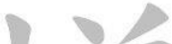
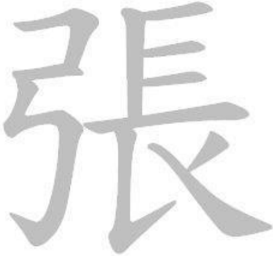
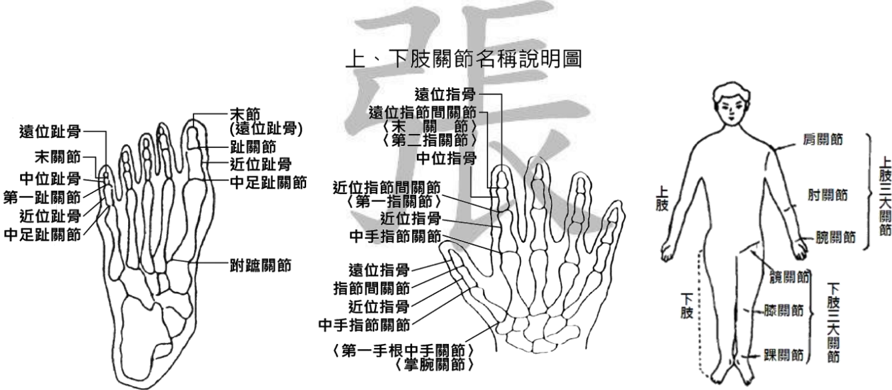
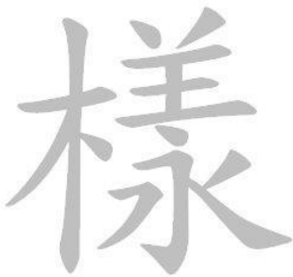
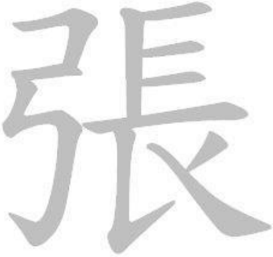
...
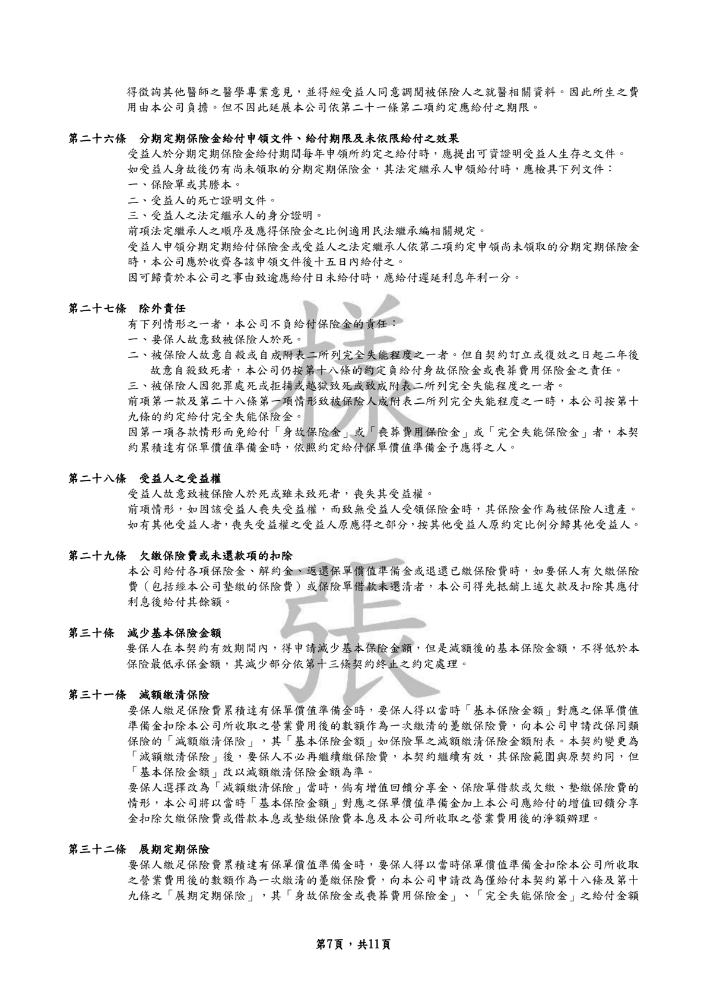
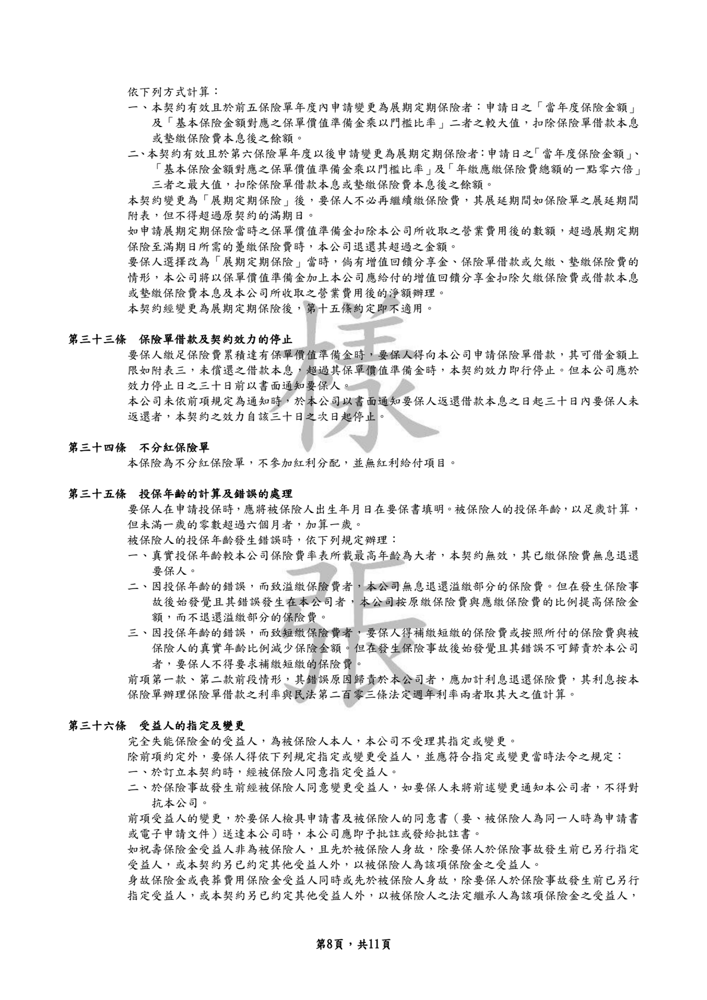
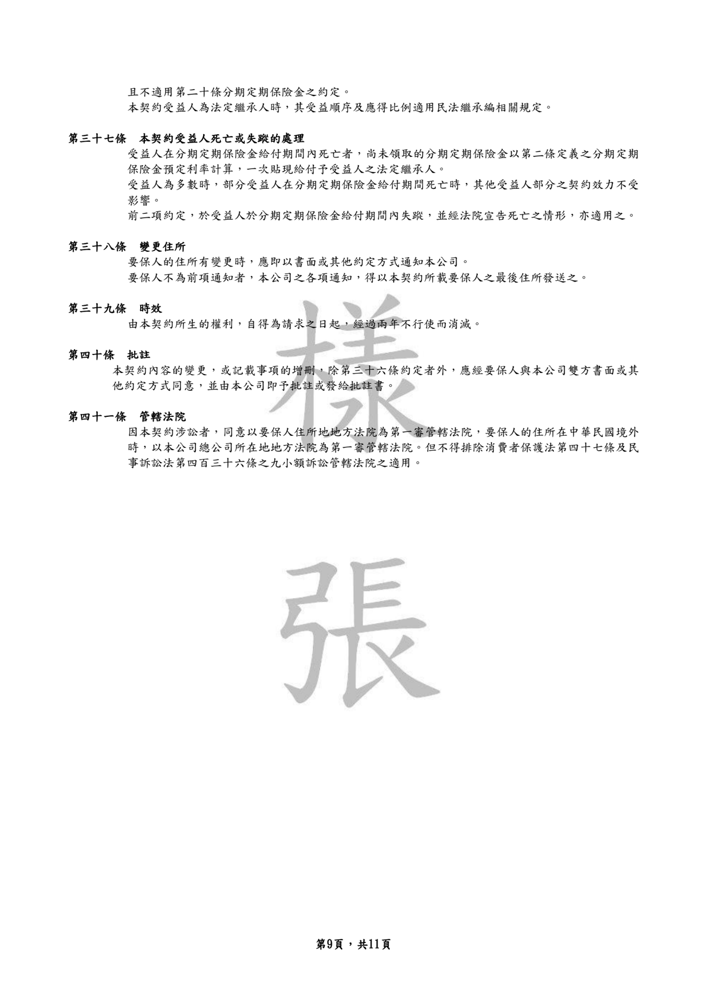
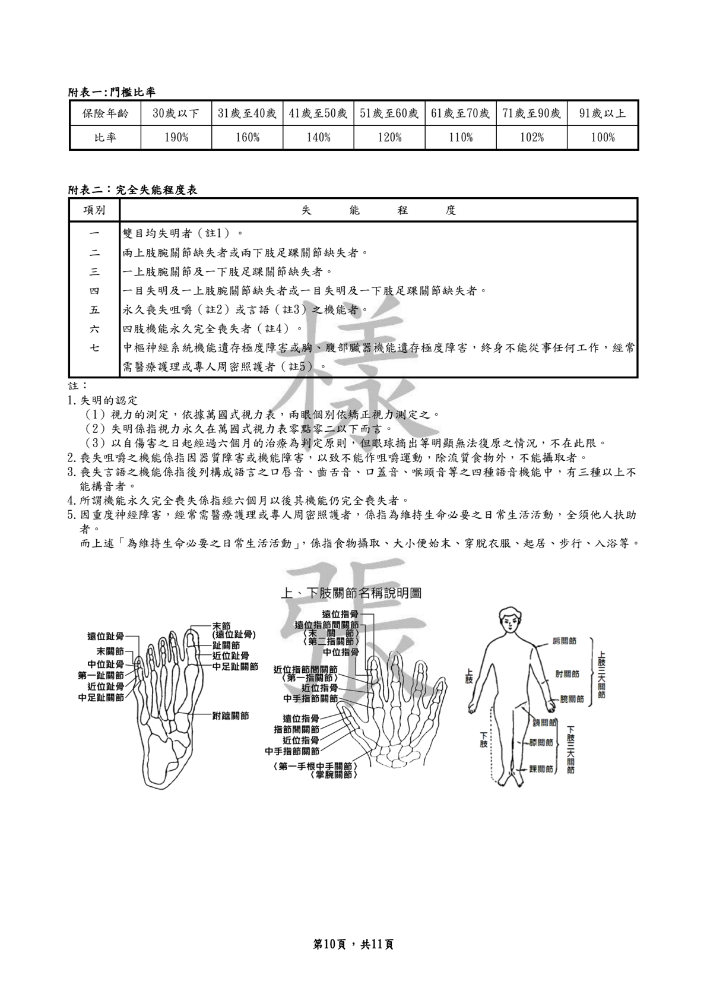
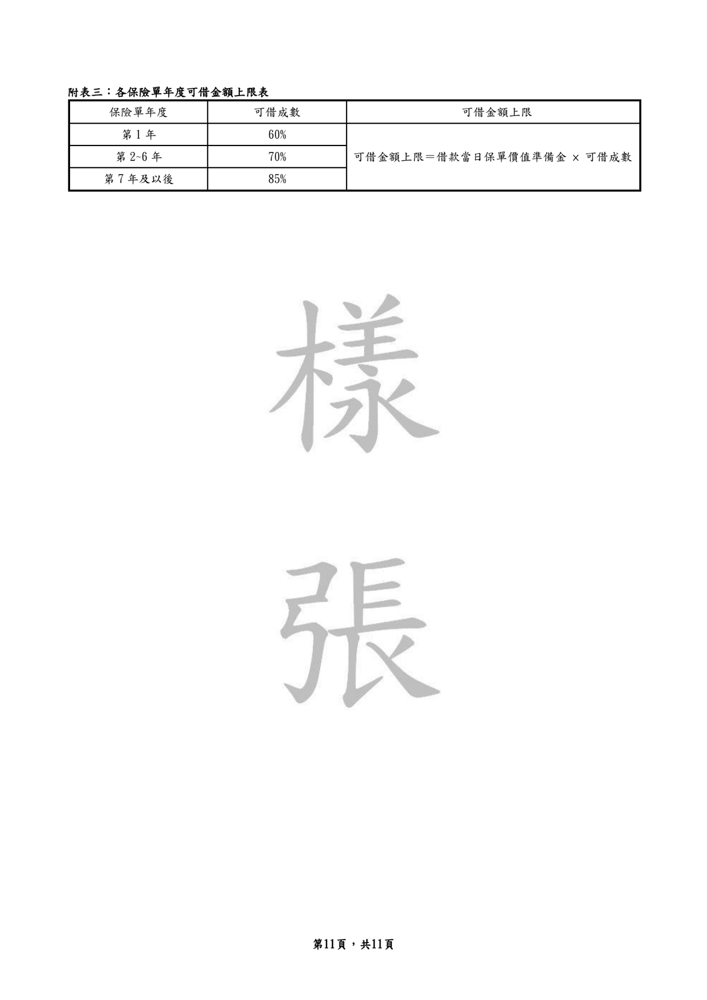

In [11]:
reader_json = DoclingReader(
    export_type=DoclingReader.ExportType.JSON,
    doc_converter=pypdfium_converter
)

dir_reader_json = SimpleDirectoryReader(
    input_dir='./test_doc',
    file_extractor={".pdf": reader_json},
).load_data()

print(dir_reader_json[0])
print('###############')
show_json(dir_reader_json[0].json())

In [12]:
node_parser_json = DoclingNodeParser()

nodes_json = node_parser_json.get_nodes_from_documents(
    dir_reader_json, show_progress=False
)

In [85]:
#print([n for n in nodes[0]])
print(nodes_json[1].text)
print('###############')
show_json(nodes_json[1].json())

本保險單條款、附著之要保書、批註及其他約定書，均為本保險契約（以下簡稱本契約）的構成部分。 本契約的解釋，應探求契約當事人的真意，不得拘泥於所用的文字；如有疑義時，以作有利於被保險人 的解釋為原則。
###############
{
    "id_": "991ad52f-c696-4a50-bd51-3e30be95aded",
    "embedding": null,
    "metadata": {
        "file_path": "/Users/yoyo/Documents/國泰/test_doc/test_textMore.pdf",
        "file_name": "test_textMore.pdf",
        "file_type": "application/pdf",
        "file_size": 388567,
        "creation_date": "2025-02-25",
        "last_modified_date": "2025-02-03",
        "schema_name": "docling_core.transforms.chunker.DocMeta",
        "version": "1.0.0",
        "doc_items": [
            {
                "self_ref": "#/texts/14",
                "parent": {
                    "$ref": "#/body"
                },
                "children": [],
                "content_layer": "body",
                "label": "text",
                "prov": [
                    {
                        "page_no": 1,
                        "bbox": {
                            "l": 81.3

In [14]:
#display([(n.text, n.metadata) for n in nodes_json[:300]])
display([(n.text) for n in nodes_json[:300]])

['（給付項目：祝壽保險金、身故保險金或喪葬費用保險金、完全失能保險金）',
 '（本保險提供身故保險金分期定期給付）',
 '（本保險為不分紅保險單，不參加紅利分配，並無紅利給付項目）',
 '（本契約與以新臺幣收付之人身保險契約間，不得辦理契約轉換）',
 '（本商品部分年齡可能發生累積所繳保險費超出身故保險金給付之情形）',
 '（申訴電話：市話免費撥打0800-036-599、付費撥打02-2162-6201；傳真：0800-211-568；電子信箱（E-mail）：',
 'service@cathaylife.com.tw）',
 '110.08.12國2國壽字第1100080120號0號函備查',
 '111 . 12 . 01國1國壽字第1110120022號2號函備查',
 '112.02.23依3依111.11.29金管保壽字第1110462568號8號函修正',
 '113.07.01 依 113.06.27 金管保壽字第 11304921171 號1 號令修正',
 '113 . 12 . 31 依 113.09.23 金管保壽字第 1130427324 號4 號函修正',
 '本保險單條款、附著之要保書、批註及其他約定書，均為本保險契約（以下簡稱本契約）的構成部分。 本契約的解釋，應探求契約當事人的真意，不得拘泥於所用的文字；如有疑義時，以作有利於被保險人 的解釋為原則。',
 '本契約名詞定義如下：',
 '-、「商品貨幣」：指本契約保險金額、保險費、各項保險金、解約金、增值回饋分享金、保險單借款 及保單價值準備金等之計價貨幣，並經記載於保險單上者（本契約商品貨幣為美元）。\n二、「匯款相關費用」：指包指包括匯款銀行所收取之匯出費用（含匯款手續費、郵電費）、收款銀行所收 取之收款手續費及中間行所收取之轉匯費用，本項費用以匯款銀行、收款銀行與中間行於匯款當時 約定之數額為準。\n三、「增值回饋分享金」：指本公司於本契約有效期間內之每-保險單週年日，按前-保險單年度宣告 利率平均值減去本契約預定利率（百分之二點二點二五）之差值，乘以前-保險單年度末保單價值準備 金所得之值。\n四、「宣告利率」：指本公司每月第-個營業日宣告，適用於本契約之當月利率，該利率係參考市場利 率及本公司運用此類商品所累積資產的實際狀況而訂定。如當月未宣告者，以前-月之

In [15]:
# Do hybrid chunking to merge similar chunk
tokenizer = AutoTokenizer.from_pretrained("BAAI/bge-m3")

hybrid_chunker = HybridChunker(
    tokenizer=tokenizer,
    merge_peers=True,  # optional, defaults to True
)

In [16]:
node_parser_json = DoclingNodeParser(chunker=hybrid_chunker)

nodes_json = node_parser_json.get_nodes_from_documents(
    dir_reader_json, show_progress=False
)

In [17]:
#print([n for n in nodes[0]])
print(nodes_json[0].text)
print('###############')
show_json(nodes_json[0].json())

（給付項目：祝壽保險金、身故保險金或喪葬費用保險金、完全失能保險金）
（本保險提供身故保險金分期定期給付）
（本保險為不分紅保險單，不參加紅利分配，並無紅利給付項目）
（本契約與以新臺幣收付之人身保險契約間，不得辦理契約轉換）
（本商品部分年齡可能發生累積所繳保險費超出身故保險金給付之情形）
（申訴電話：市話免費撥打0800-036-599、付費撥打02-2162-6201；傳真：0800-211-568；電子信箱（E-mail）：
service@cathaylife.com.tw）
110.08.12國2國壽字第1100080120號0號函備查
111 . 12 . 01國1國壽字第1110120022號2號函備查
112.02.23依3依111.11.29金管保壽字第1110462568號8號函修正
113.07.01 依 113.06.27 金管保壽字第 11304921171 號1 號令修正
113 . 12 . 31 依 113.09.23 金管保壽字第 1130427324 號4 號函修正
###############
{
    "id_": "f9beb9fa-f381-4833-9cba-33b5540d7f69",
    "embedding": null,
    "metadata": {
        "file_path": "/Users/yoyo/Documents/國泰/test_doc/test_textMore.pdf",
        "file_name": "test_textMore.pdf",
        "file_type": "application/pdf",
        "file_size": 388567,
        "creation_date": "2025-02-25",
        "last_modified_date": "2025-02-03",
        "schema_name": "docling_core.transforms.chunker.DocMeta",
        "version": "1.0.0",
        "doc_items": [
            {
                "self_ref": "#

In [18]:
print(nodes_json[87].text)
print('###############')
show_json(nodes_json[87].json())

單位：美元日/日元/日
亞洲地區, 總經理級以上主管   宿費 餐雜費.宿費 = . 亞洲地區, 總經理級以上主管   宿費 餐雜費.餐雜費 = . 亞洲地區, 高階主管.宿費 = . 亞洲地區, 高階主管.餐雜費 = . 亞洲地區, 協理級(含)   以下人員   宿費 餐雜費.宿費 = . 亞洲地區, 協理級(含)   以下人員   宿費 餐雜費.餐雜費 = . 中國大陸, 總經理級以上主管   宿費 餐雜費.宿費 = 檢據實支. 中國大陸, 總經理級以上主管   宿費 餐雜費.餐雜費 = 110或檢據實支. 中國大陸, 高階主管.宿費 = 270. 中國大陸, 高階主管.餐雜費 = 110. 中國大陸, 協理級(含)   以下人員   宿費 餐雜費.宿費 = 215. 中國大陸, 協理級(含)   以下人員   宿費 餐雜費.餐雜費 = 95. 日本(Japan), 總經理級以上主管   宿費 餐雜費.宿費 = 檢據實支. 日本(Japan), 總經理級以上主管   宿費 餐雜費.餐雜費 = 140或檢據實支. 日本(Japan), 高階主管.宿費 = 345. 日本(Japan), 高階主管.餐雜費 = 140. 日本(Japan), 協理級(含)   以下人員   宿費 餐雜費.宿費 = 275. 日本(Japan), 協理級(含)   以下人員   宿費 餐雜費.餐雜費 = 105. 南韓(Korea), 總經理級以上主管   宿費 餐雜費.宿費 = 檢據實支. 南韓(Korea), 總經理級以上主管   宿費 餐雜費.餐雜費 = 130或檢據實支. 南韓(Korea), 高階主管.宿費 = 315. 南韓(Korea), 高階主管.餐雜費 = 130. 南韓(Korea), 協理級(含)   以下人員   宿費 餐雜費.宿費 = 255. 南韓(Korea), 協理級(含)   以下人員   宿費 餐雜費.餐雜費 = 110. 菲律賓(Philippines), 總經理級以上主管   宿費 餐雜費.宿費 = 檢據實支. 菲律賓(Philippines), 總經理級以上主管   宿費 餐雜費.餐雜費 = 105或檢據實支. 菲律賓(Philippines), 高階主管.宿費 = 260. 菲律賓(Philippines), 高階主管.餐雜費 = 105.

In [19]:
if not os.path.exists("./storage/json_db"):
    index = VectorStoreIndex(nodes_json)
    # make vector store persistant
    index.storage_context.persist(persist_dir="./storage/json_db")
else:
    # load vector store indexed if they exist
    index = load_index_from_storage(
        StorageContext.from_defaults(persist_dir="./storage/json_db"),
        node_parser=node_parser_md
    )

# Testing

In [271]:
llama_index = load_index_from_storage(
        StorageContext.from_defaults(persist_dir="./storage/llama_db"),
        node_parser=node_parser
    )
doclingMD_index = load_index_from_storage(
        StorageContext.from_defaults(persist_dir="./storage/md_db"),
        node_parser=node_parser_md
    )
doclingJSON_index = load_index_from_storage(
        StorageContext.from_defaults(persist_dir="./storage/json_db"),
        node_parser=node_parser_md
    )

In [ ]:
indexs = {
    "llama": llama_index,
    "doclingMD": doclingMD_index,
    "doclingJSON": doclingJSON_index
}

# post process reranker
reranker = SentenceTransformerRerank(
    model="BAAI/bge-reranker-large", top_n=5
)

# Set up the similarity postprocessor with a cutoff
similarity_postprocessor = SimilarityPostprocessor(similarity_cutoff=0.7)

retrievers = {}
query_engines = {}
chat_engines = {}

for name, index in indexs.items():
    # configure retriever
    # Vector index retriever
    '''
    retriever = VectorIndexRetriever(
        index=index,
        similarity_top_k=2
    )
    '''
    # RAG Fusion retriever
    retriever = QueryFusionRetriever(
        #[index.as_retriever(similarity_top_k=2), BM25Retriever.from_defaults(docstore=index.docstore, similarity_top_k=2)],
        [index.as_retriever(similarity_top_k=5)],
        similarity_top_k=5,
        num_queries=1,  # generated query num
        #mode="reciprocal_rerank",
        #mode="dist_based_score",
        use_async=False,
        # query_gen_prompt="...",  # self defined query prompt template
    )
    retrievers[name] = retriever  # save in retrievers dict
    
    # single round query engine
    query_engine = RetrieverQueryEngine(
        retriever=retriever,
        node_postprocessors=[similarity_postprocessor, reranker]
    )
    query_engines[name] = query_engine  # save in query_engines dict

    # chat engine
    chat_engine = ContextChatEngine.from_defaults(
        retriever=retriever,
        query_engine=query_engine
         # condense_question_prompt=... # self defined chat message prompt template
    )
    chat_engines[name] = chat_engine  # save in chat_engines dict


# test query
'''
response = query_engines["llama"].query("你好")
print(response)
'''

'\nresponse = query_engines["llama"].query("你好")\nprint(response)\n'

In [273]:
# Do query, response with answer and print out retrieved node

def get_response_with_nodes(chat_engine, question):
    
    # get response
    response = chat_engine.chat(question)
    print(f"\n===== Chat Engine Response =====")
    print(response)

    # print out retrieved node context and metadata
    print("\n===== Retrieved Nodes =====")
    if response.source_nodes:
        for i, node in enumerate(response.source_nodes, start=1):
            print(f"\n🔹 Score: {node.score:.2f} - Node {i}:")
            print(f"Text: {node.text}")
            #print(f"Metadata: {node.metadata}")
    else:
        print("⚠️ No nodes retrieved.")
    
    return None

for name, chat_engine in chat_engines.items():
    chat_engine.reset()

In [199]:
user_query = "我是科主管，要國內出差，可以申請多少全日雜費、宿費、交通費？"

for name, chat_engine in chat_engines.items():
    print(f"\n===== Chat Engine: {name} =====")
    get_response_with_nodes(chat_engine, user_query)


===== Chat Engine: doclingMD =====

===== Chat Engine Response =====
<think>
好，我需要帮助一位科主管了解国内出差时可以申请的杂费、宿费和交通费的具体标准。首先，我会仔细阅读提供的上下文文件，找出相关的规定。

在《國泰金控员工 domestic trip vouchers.pdf》中，第四条提到员工出差的杂费和住宿费根据附件的标准支给。第五条补充了单程超过100公里需要申请住宿费，并以当天返回原则处理交通费。

接着，在《國泰金控employees domestic travel voucher.pdf》中，第三条指出跨境差旅的住宿费和其他杂费需依照附表一的标准支给。第四条提到机票费和其他交通工具费用可以按附表二报销，但需要发票支持，并且必须按照指定的路程报销交通费。

附件三列出了不同职位人员的保险保额，可能对实际可报销范围有帮助，但暂时不直接回答费用问题。第七条关于海外境内交通费的报销标准，虽然提到了附表四，但主要涉及国际旅行，所以可能与当前的问题不太相关。

第六条提到出差所需的必要费用如签证、机机场服务费等需要据证报销，其他未列项的费用需根据具体情况处理。

总结一下：
1. 杂费和住宿费遵循附件一的标准。
2. 单程超过100公里需申请住宿费，交通费按实际报销。
3. 交通费按附表二规定支给，并需发票支持。

需要进一步确认这些信息是否准确无误，并根据科主管的职位可能享受的特殊待遇进行调整。同时，确保所有规定都已正确引用和解释，避免遗漏关键细节。

最终答案如下：
根據《國泰金控员工 domestic trip vouchers.pdf》和《國泰金控employees domestic travel voucher.pdf》，以下是出差相关费用的规定：

1. **杂费（Accumulation Allowance）**：
   - 根據附件一的标准支给。

2. **住宿费 (Accommodation Expense)**：
   - 按照第五条的规定，单程路程超过 100 公里以上者需申請住宿費，並以当天返回任所為原則處理交通費。

3. **交通费 (Transportation Expense)**：
   - 機票費及其他交通工具費用按附表二规定支给，並需檢據Sup

In [42]:
user_query = "給我國外出差的附表三：投保標準"

for name, chat_engine in chat_engines.items():
    print(f"\n===== Chat Engine: {name} =====")
    get_response_with_nodes(chat_engine, user_query)


===== Chat Engine: doclingMD =====

===== Chat Engine Response =====
<think>
好的，我需要帮助用户查询“我国外出差的附表三：投保标准”。根据之前的对话和提供的政策文件内容，我知道附表三主要涉及不同职涯人员的保险保额和标准。

首先，查看文件路径：/Users/yoyo/Documents/國泰/test_doc/國泰金控員工國外出差要點.pdf。这表明文档是关于员工出国出差的要点，其中包括投保标准的部分。

接着，附件部分提供了具体的投保标准表格。表格中根据职位不同，每人投保保额分为四个部分：
1. 意外(傷害) 死殘保險：200万、160万、1200万和1200万。
2. 傷害醫療限額：每个保额对应的10%。
3. 海外突發 疾病醫療(含燒燙傷) 保險限額（註）：同上。
4. 海外旅遊 不便保險：同上。

用户是科主管，属于“科主管及相当职级”，所以对应的每人投保保额是1200万元。此外，表格中提到以保費較低組合為限，并且有备注规定保额可能因地区不同而有所调整。

由于用户的问题直接询问出国出差的附表三，因此我需要将附件中的表格内容准确地复制过来，并进行适当的解释和格式化，以便用户理解具体的投保标准。
</think>

以下是根据政策文件中的内容，整理出我国外出差的投保标准（附表三）：

---

### **附表三：投保標準**

|                | 每人投保保額          | 每人投保保額              | 每人投保保額                               | 每人投保保額           |
|----------------|-----------------------|---------------------------|--------------------------------------------|------------------------|
|                | 意外(傷害)   死殘保額 | 傷害醫療限額              | 海外突發  疾病醫療(含燒燙傷)  保險限額(註) | 海外旅遊  不便保險     |
| 總經理(含)以上 | 2,000 萬元  

In [43]:
get_response_with_nodes(chat_engines['doclingJSON'], '我想要看到國外出差資訊中的附表三：投保標準，我想知道意外(傷害)死殘保額多少')


===== Chat Engine Response =====
<think>
好的，我现在需要仔细分析用户的需求，并尝试理解他们为什么如此关心这个问题。

用户之前询问了出国出差的费用标准，我告诉他可以申请300元的日杂费、住宿费和交通费。现在，他进一步询问附表三的具体内容——意外伤害（包括伤害）、死亡残保额是多少。

首先，用户可能是员工，需要了解具体的保险项目和保额。他在关心意外伤害和死残保额，这可能是因为他计划出国出差，并且想知道保险是否足够覆盖可能的损失。

从对话历史来看，我无法查看外部文件或附件内容，包括附表三的具体数据。因此，在回复中明确告知用户这一点是必要的，避免误导他们。

此外，用户可能希望获得具体的数字来评估自己的需求。因此，建议他们联系公司或保险公司获取最新的保额信息，并根据具体情况决定是否需要调整保险计划。

最后，我应该表达愿意帮助的意愿，并引导用户提供更多信息，以便我能更好地协助解决他们的疑问。
</think>

抱歉，我无法直接访问外部文件或查看附件内容（如附表三）。因此，我无法提供附表三的具体内容或意外伤害（傷害）和死亡残保额的具体数值。

如果您需要了解出国出差保险的相关标准，请您联系公司财务部门或保险部门，或者参考公司的官方文件和规定。通常，这些信息会有详细的标准说明。

如果还有其他问题，请随时告诉我！

===== Retrieved Nodes =====

🔹 Score: 0.07 - Node 1:
Text: 奉派出國人員得以出國公假日數為保險期間，投保子公司旅遊保險中之意外(傷(傷害)死殘保險、 傷害醫療保險、海外突發疾病醫療(含(含燒燙傷)保)保險、海外旅遊不便保險，其標準如附表三。

🔹 Score: 0.03 - Node 2:
Text: 單位：新台幣
, 每人投保保額 = 意外(傷害)   死殘保額. , 每人投保保額 = 傷害醫療限額. , 每人投保保額 = 海外突發  疾病醫療(含燒燙傷)  保險限額(註). , 每人投保保額 = 海外旅遊  不便保險. 總經理(含)以上, 每人投保保額 = 2,000 萬元. 總經理(含)以上, 每人投保保額 = 意外(傷害)   死殘保額 10%. 總經理(含)以上, 每人投保保額 = 意外(傷害)   死殘保額 10%. 總經理(含)以上, 每人投保保

In [270]:
for name, chat_engine in chat_engines.items():
    chat_engine.reset()

In [230]:
user_query = "系統開發之安全管理，應包含哪些項目？"

for name, chat_engine in chat_engines.items():
    print(f"\n===== Chat Engine: {name} =====")
    get_response_with_nodes(chat_engine, user_query)


===== Chat Engine: doclingMD =====

===== Chat Engine Response =====
<think>
嗯，我现在需要回答一个问题：“系統開發之安全管理，應包含哪些項目？”首先，我得理解用户的需求。他们可能是在进行系统开发项目时，想了解在安全管理方面应该考虑哪些方面的内容。

根据提供的文档信息，主要是关于公司信息安全的管理办法，里面有第三条、第四条等条款，提到了信息安全的目标和范围。同时，在适用对象及范围部分，详细列出了公司的信息资产包括数据文件、服务器设备、物理环境和信息系统软件。

附則部分还提到，如果违反规定影响权益，会有相应的处理机制。这些都对系统开发中的安全管理有一定的指导意义。

接下来，我需要将这些文档内容转化为具体的项目条目。通常，在系统开发的安全管理中会涉及以下几个方面：

1. **安全管理架构**：明确安全目标、组织结构和职责分配。
2. **风险分析与评估**：识别潜在风险，并评估其影响。
3. **变更控制**：对变更进行审批，确保变更符合安全标准。
4. **安全需求集成**：将安全需求融入系统开发 lifecycle中。
5. **加密管理**：确保数据和传输的安全性。
6. **访问控制**：实施严格的权限管理和授权。
7. **审计与日志记录**：跟踪系统的使用情况，便于追溯和审计。
8. **测试与验证**：在开发过程中进行安全测试，确保系统符合要求。
9. **合规性**：确保项目符合相关法律法规和行业标准。

结合文档中的信息，特别是关于信息安全的目标和涵盖的范围，可以进一步细化这些条目。例如，在风险管理方面，可以考虑如何识别和评估系统开发过程中的潜在风险，并制定应对措施。在变更控制中，可能需要检查每个变更是否影响到信息安全资产，以及是否符合现有的安全政策。

此外，文档中提到的员工意识提升也很重要，确保相关人员理解并遵守安全管理规定。因此，在项目管理阶段，可能会有专门的安全培训和意识提升计划作为一部分。

最后，需要将这些思考整理成一个清晰、有条理的回答，分点列出，并且尽量结合具体的文档内容，以展示对问题的深入理解和如何将理论应用到实际项目中。
</think>

在 system development 的安全管理中，应包含以下几个方面的内容：

### 1. 系統開發

# Some function testing

In [115]:
from CH_BM25Retriever import ChineseBM25Retriever

In [274]:
from llama_index.retrievers.bm25 import BM25Retriever
from llama_index.core import Document
from llama_index.core.node_parser import SentenceSplitter
from llama_index.core.response.notebook_utils import display_source_node

documents = [Document(text="床前明月光"),
             Document(text="疑是地上霜"),
             Document(text="舉頭望明月"),
             Document(text="低頭思故鄉")]

splitter = SentenceSplitter(chunk_size=1024)
nodes = splitter.get_nodes_from_documents(documents)

retriever = BM25Retriever.from_defaults(
    nodes=nodes,
    similarity_top_k=2,
)

nodes = retriever.retrieve("故鄉")
for node in nodes:
    display_source_node(node)

**Node ID:** c7837e35-f971-4bd4-b93f-88477ed0382e<br>**Similarity:** 0.0<br>**Text:** 低頭思故鄉<br>

**Node ID:** 56ac86bd-1794-4412-ae50-442e04ba3899<br>**Similarity:** 0.0<br>**Text:** 舉頭望明月<br>

In [141]:
from llama_index.core.evaluation import SemanticSimilarityEvaluator
from llama_index.core.embeddings import resolve_embed_model
from llama_index.core.base.embeddings.base import SimilarityMode


embed_model = resolve_embed_model(Settings.embed_model)
evaluator = SemanticSimilarityEvaluator(
    embed_model=embed_model,
    similarity_mode=SimilarityMode.DEFAULT,
    similarity_threshold=0.6,
)

In [ ]:
target_node = list(doclingMD_index.docstore.docs.values())[74]

response = '''## 第八條(修(修訂及施行)

本要點之訂定、修正或廢止應經總經理同意。

本要點自訂定日起生效施行，修正或廢止時亦同。

附件：國內出差雜、宿、交通費標準

| 人員/項目          | 全日雜費    | 宿費           | 交通費                                                                                              |
|--------------------|-------------|----------------|-----------------------------------------------------------------------------------------------------|
| 總經理以上         | 檢據實支    | 檢據實支       | 檢據實支                                                                                            |
| 高階主管           | 檢據實支    | 檢據實支       | 檢據實支                                                                                            |
| 部室主管及相當職級 | 每日 300 元 | 元核支交通費。 | 1. 以飛機經濟艙、高鐵  標準車廂或自強號之                                                           |
| 科主管及相當職級   | 每日 300 元 | 元核支交通費。 | 價格為上限。  2. 如自行開車者，依自  強號每公計                                                     |
| 其他人員           | 每日 300 元 | 元核支交通費。 | 元核支交通費。  3. 搭乘計程車往返機場  或車站者，補貼計程  車 費 用 單 程 上 限  350 元，檢據實支。 |

備註：

- -、本公司員工於國內出差時應檢具實支，金額上限如前表；無法檢具實支者，則以 金額上限支給。
- 二、本要點所稱「高階主管」係指部室主管(不含)以上，總經理(不含)以下之主管。
- 三、員工出差如搭乘飛機或高鐵，可縮短時間、減少雜費與宿費而節省出差旅費時， 可逕行搭乘(高(高階主管以上人員檢據實支，部室主管級以下人員飛機限搭經濟艙、 高鐵限搭標準車廂)。
- 四、括弧內金額為員工出差及住宿地為雙為雙北地區地區時之宿費核給標準。
- 五、部室主管級以下人員隨同高階主管以上人員出差時，宿費得比照實支，但以投宿 同-飯店之較低標準房型為限。
- 六、超過中午 12 點2 點得申請半日雜費、超過 18 點8 點則以全日計。'''

#response = target_node.text

reference = "我是科主管，要國內出差，可以申請多少全日雜費、宿費、交通費？"

result = await evaluator.aevaluate(
    response=response,
    reference=reference,
)

print("Score: ", result.score)
print("Passing: ", result.passing)

Score:  0.7131999546541079
Passing:  True


In [209]:
response = "國內出差"
reference = "國外出差"

result = await evaluator.aevaluate(
    response=response,
    reference=reference,
)
print("Score: ", result.score)
print("Passing: ", result.passing)

Score:  0.8834432988823547
Passing:  True


In [247]:
response = '''- 第十-條 本公司系統開發及維護之護之安全管理，資訊處、數數發中心或心或 受委託者應者應依下列規定辦理：
- -、 系統開發應於初始階段考量安控機制之布置，委託委託開託開發部分應

第 6 頁6 頁/共 8 頁8 頁

強化控管資訊安全並於合約載明相關義務， 系統開發應注意時 程之掌控，避免延誤脫序。

- 二、 系統開統開發之安全管理，應包含下列項目：
- (-) 需求提出階段之安全管理。
- (二) 系統分析階段之安全管理。
- (三) 系統設計階段之安全管理。
- (四) 系統測試階段之安全管理。
- (五) 系統驗收及上線階段之安全管理。
- 三、 系統變更之安全管理，應包含下列項目：
- (-) 原始碼之安全管理。
- (二) 程式佈署之安全管理。
- (三) 緊) 緊急變更之安全管理。

四、 測試環境與正式環境應分別獨立於不同電腦作業環境。'''
reference = "系統開發之安全管理，應包含哪些項目？"

result = await evaluator.aevaluate(
    response=response,
    reference=reference,
)
print("Score: ", result.score)
print("Passing: ", result.passing)

Score:  0.7848638514177928
Passing:  True


In [258]:
first_node = list(doclingJSON_index.docstore.docs.values())[102]
print(first_node.text)

第四條 本公司資訊財訊財產安全管理作理作業之權之權責職掌應掌應適應適當劃分，並視需要建立 代理人制度。
本公司資司資訊財訊財產相產相關業務於委於委託「受「受委託者 」 辦理前理前，應與其簽其簽署簽署合署合 約並納並納入本辦法中「受「受委託者」應遵循之相之相關事項。
第五條 本公司員司員工之工之資訊安全教育訓練，應依下列規定辦理：
-、 各級主管須負責督導所屬員工之資訊作業安全，防範不法及不當 行為。
二、所、所有員有員工須依須依公司安排之課程參與資訊安全教育訓練，以瞭解維 護資訊安全為每位員工之義務，且於執行各項作業時，應確保所 執行作業之資訊安全，對執行業務過程中所得知之資訊，應嚴格 保密，其保密義務不因調離職而免而免除。
三、資訊安全部得視實際需要辦理或責成相關單位執行資訊安全教 育訓練及宣導，以建立員工資訊安全認知，並提升公司整體資訊 安全水準。
第六條 資訊財訊財產管理，應依下列規定辦理：
-、 本公司資司資訊財訊財產之使用 ，應遵應遵循本公司及司及受本公司委託管理維 運公司之相之相關規範。
二、 本公司嚴司嚴禁使禁使用來源不明之儲存媒體及非法軟體程式或未經公 司許司許可之軟體，所，所有員工及工及受及受委託者，均有責任及義務保護其所 取得或使用之本公司資訊財訊財產，並防止未經授權之存之存取、擅改、 破壞或不當揭露，以確保資訊財訊財產之機密性、完整性及可用性。
三、 本公司資 司資 訊 財訊 財產 應由應由資訊處或受委託者安裝管控軟體及體及防毒
第 2 頁2 頁/共 8 頁8 頁
軟體並開啟即時掃瞄功能，惟若符若符合《辦公室資訊作業管理要 點》規範之例之例外狀況，得依得依該依該要點辦理。
四、 本公司資訊財訊財產應由應由資訊處或受委託者啟者啟動存動存取軌取軌跡，惟若有若有 將資訊複訊複製或製或移或移動至外至外部儲存裝置之需求者求者，應遵循《辦公室資 訊作業管理要點》進行申行申請並取並取得核准，資訊處或受委託者並須並須 將複將複製或製或移或移動之資訊留訊留存紀錄。
五、 本公司硬司硬體資體資訊財訊財產，如經評估不堪使用或用或不再不再使再使用使用時用時，應依應依 《辦公室資訊作業管理要點》進行報行報廢報廢程序後，方可進行處分或 報廢。
第七條 就本公司資司資訊財訊財產實產實體與資與資訊安全管制區制區域之安全，資，資訊處、數位 數據暨科技發展中心(以下簡稱數數發中心

In [259]:
test_node = list(doclingMD_index.docstore.docs.values())[93]
print(test_node.text)

## 資訊財訊財產安全管理作理作業

第四條 本公司資訊財訊財產安全管理作理作業之權之權責職掌應掌應適應適當劃分，並視需要建立 代理人制度。

本公司資司資訊財訊財產相產相關業務於委於委託「受「受委託者 」 辦理前理前，應與其簽其簽署簽署合署合 約並納並納入本辦法中「受「受委託者」應遵循之相之相關事項。

- 第五條 本公司員司員工之工之資訊安全教育訓練，應依下列規定辦理：
- -、 各級主管須負責督導所屬員工之資訊作業安全，防範不法及不當 行為。
- 二、所、所有員有員工須依須依公司安排之課程參與資訊安全教育訓練，以瞭解維 護資訊安全為每位員工之義務，且於執行各項作業時，應確保所 執行作業之資訊安全，對執行業務過程中所得知之資訊，應嚴格 保密，其保密義務不因調離職而免而免除。
- 三、資訊安全部得視實際需要辦理或責成相關單位執行資訊安全教 育訓練及宣導，以建立員工資訊安全認知，並提升公司整體資訊 安全水準。

第六條 資訊財訊財產管理，應依下列規定辦理：

- -、 本公司資司資訊財訊財產之使用 ，應遵應遵循本公司及司及受本公司委託管理維 運公司之相之相關規範。
- 二、 本公司嚴司嚴禁使禁使用來源不明之儲存媒體及非法軟體程式或未經公 司許司許可之軟體，所，所有員工及工及受及受委託者，均有責任及義務保護其所 取得或使用之本公司資訊財訊財產，並防止未經授權之存之存取、擅改、 破壞或不當揭露，以確保資訊財訊財產之機密性、完整性及可用性。
- 三、 本公司資 司資 訊 財訊 財產 應由應由資訊處或受委託者安裝管控軟體及體及防毒

第 2 頁2 頁/共 8 頁8 頁

軟體並開啟即時掃瞄功能，惟若符若符合《辦公室資訊作業管理要 點》規範之例之例外狀況，得依得依該依該要點辦理。

- 四、 本公司資訊財訊財產應由應由資訊處或受委託者啟者啟動存動存取軌取軌跡，惟若有若有 將資訊複訊複製或製或移或移動至外至外部儲存裝置之需求者求者，應遵循《辦公室資 訊作業管理要點》進行申行申請並取並取得核准，資訊處或受委託者並須並須 將複將複製或製或移或移動之資訊留訊留存紀錄。
- 五、 本公司硬司硬體資體資訊財訊財產，如經評估不堪使用或用或不再不再使再使用使用時用時，應依應依 《辦公室資訊作業管理要點》進行報行報廢報廢程序後，方可進行處分或 報廢。
- 第七條 就本公司資司資訊財訊財產實產實

In [ ]:
# Initialize the SemanticSplitterNodeParser
semantic_splitter = SemanticSplitterNodeParser(
    embed_model=Settings.embed_model,
    buffer_size=1,
    breakpoint_percentile_threshold=10
)
# Rechunk the large node
rechunked_nodes = semantic_splitter.get_nodes_from_documents([test_node])
for node in rechunked_nodes:
    print(f'======Node Content======\n {node.text}\n')

'''
# Replace the large node with the rechunked nodes in your original list
original_nodes = list(doclingMD_index.docstore.docs.values())
original_nodes.remove(test_node)
original_nodes.extend(rechunked_nodes)
# Print the content of the updated nodes
for node in original_nodes:
    print(f"Node Content: {node.text}\n")
'''

======Node Content======
 ## 資訊財訊財產安全管理作理作業

第四條 本公司資訊財訊財產安全管理作理作業之權之權責職掌應掌應適應適當劃分，並視需要建立 代理人制度。

本公司資司資訊財訊財產相產相關業務於委於委託「受「受委託者 」 辦理前理前，應與其簽其簽署簽署合署合 約並納並納入本辦法中「受「受委託者」應遵循之相之相關事項。

- 第五條 本公司員司員工之工之資訊安全教育訓練，應依下列規定辦理：
- -、 各級主管須負責督導所屬員工之資訊作業安全，防範不法及不當 行為。
- 二、所、所有員有員工須依須依公司安排之課程參與資訊安全教育訓練，以瞭解維 護資訊安全為每位員工之義務，且於執行各項作業時，應確保所 執行作業之資訊安全，對執行業務過程中所得知之資訊，應嚴格 保密，其保密義務不因調離職而免而免除。
- 三、資訊安全部得視實際需要辦理或責成相關單位執行資訊安全教 育訓練及宣導，以建立員工資訊安全認知，並提升公司整體資訊 安全水準。

第六條 資訊財訊財產管理，應依下列規定辦理：

- -、 本公司資司資訊財訊財產之使用 ，應遵應遵循本公司及司及受本公司委託管理維 運公司之相之相關規範。
- 二、 本公司嚴司嚴禁使禁使用來源不明之儲存媒體及非法軟體程式或未經公 司許司許可之軟體，所，所有員工及工及受及受委託者，均有責任及義務保護其所 取得或使用之本公司資訊財訊財產，並防止未經授權之存之存取、擅改、 破壞或不當揭露，以確保資訊財訊財產之機密性、完整性及可用性。
- 三、 本公司資 司資 訊 財訊 財產 應由應由資訊處或受委託者安裝管控軟體及體及防毒

第 2 頁2 頁/共 8 頁8 頁

軟體並開啟即時掃瞄功能，惟若符若符合《辦公室資訊作業管理要 點》規範之例之例外狀況，得依得依該依該要點辦理。

- 四、 本公司資訊財訊財產應由應由資訊處或受委託者啟者啟動存動存取軌取軌跡，惟若有若有 將資訊複訊複製或製或移或移動至外至外部儲存裝置之需求者求者，應遵循《辦公室資 訊作業管理要點》進行申行申請並取並取得核准，資訊處或受委託者並須並須 將複將複製或製或移或移動之資訊留訊留存紀錄。
- 五、 本公司硬司硬體資體資訊財訊財產，如經評估不堪使用或用或不再不再使再使用使用時用時，應依應依 《辦公室資訊作業管理要點》進行報行報廢報廢程序後，方可進行處分或

'\n# Replace the large node with the rechunked nodes in your original list\noriginal_nodes = list(doclingMD_index.docstore.docs.values())\noriginal_nodes.remove(test_node)\noriginal_nodes.extend(rechunked_nodes)\n# Print the content of the updated nodes\nfor node in original_nodes:\n    print(f"Node Content: {node.text}\n")\n'